In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

In [11]:
genre_data = pd.read_csv("data-set/data_by_genres.csv")

In [12]:
genre_data.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [42]:
print(len(pd.unique(genre_data['genres'])))

2973


In [13]:
data = pd.read_csv("data-set/data.csv")

In [14]:
data.head(3)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339


In [15]:
year_data = pd.read_csv("data-set/data_by_year.csv")

In [16]:
year_data.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [8]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [17]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

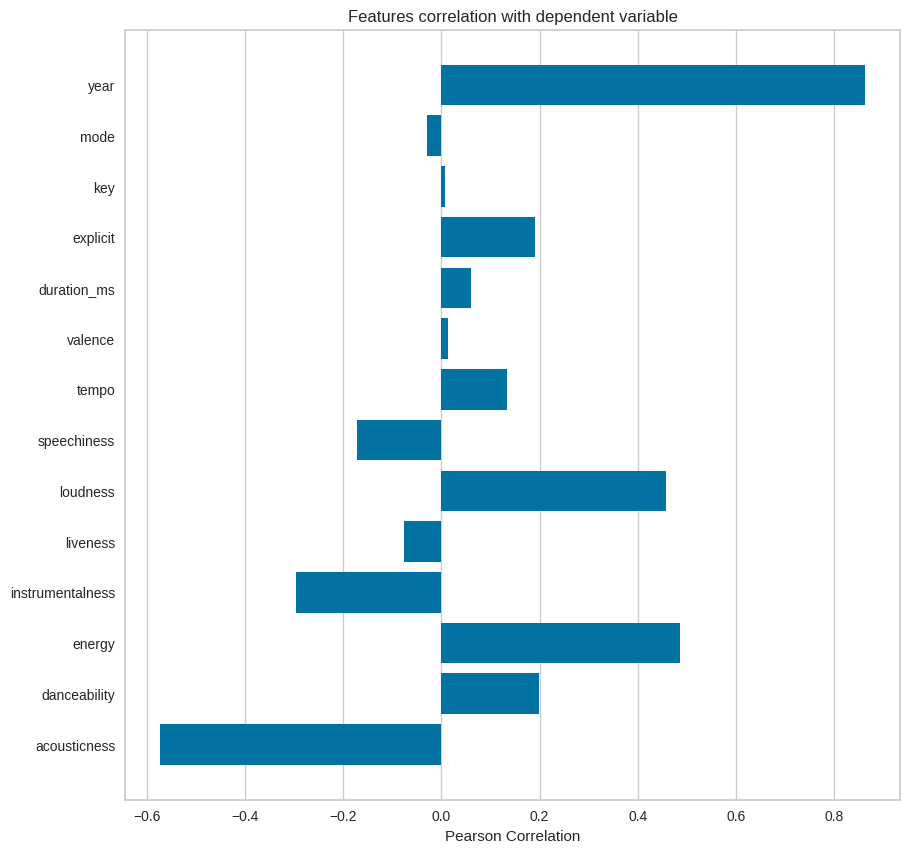

<AxesSubplot: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [18]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

features = np.array(feature_names)

visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(10,10)
visualizer.fit(X, y)
visualizer.show()

In [19]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

<function matplotlib.pyplot.show(close=None, block=None)>

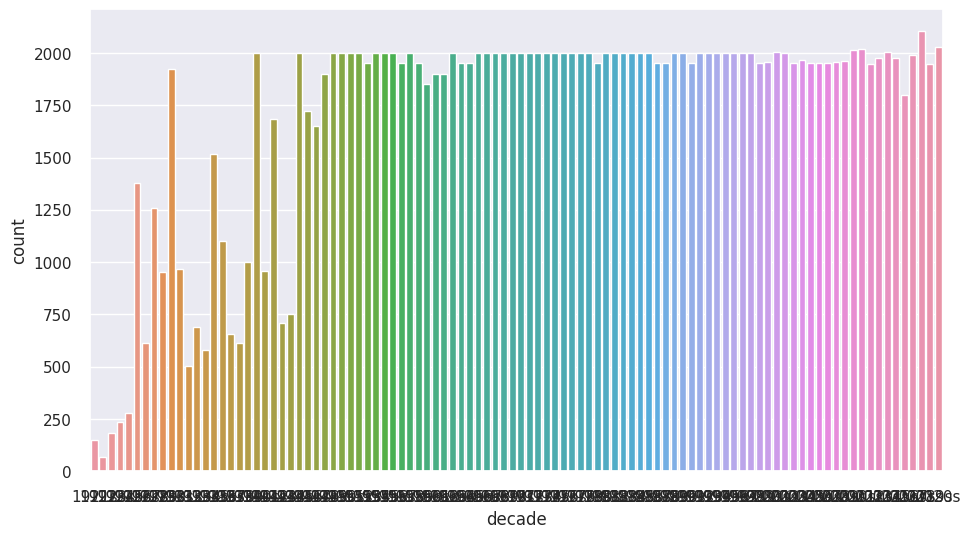

In [36]:
def get_decade(year):
    period_start = int((year/10) * 10)
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

data.info()
# sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(x=data['decade'])
plt.show

In [60]:
"""clustering genre based on genre musical features because consider a genre american pop and canadian pop , 
their musical features are almost similar so they are clustered together. Now a user listening to american pop 
will have a higher probability that the user may also like canadian pop"""

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline


model= Pipeline([('scaler',StandardScaler()),('kmeans',KMeans(n_clusters=100))])


x=genre_data.select_dtypes(np.number)

#model training and prediction to form the cluster column in g
model.fit(x)
genre_data['cluster']=model.predict(x)


In [55]:
from sklearn.model_selection import GridSearchCV

pipe=Pipeline([('scaler',StandardScaler()),('kmeans',KMeans())])
search_space={
    'kmeans__n_clusters':[10,20,50,100]
}

clf=GridSearchCV(estimator=pipe,
                 param_grid=search_space,
                 cv=5,
                 return_train_score=False)
clf.fit(x)


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('kmeans', KMeans())]),
             param_grid={'kmeans__n_clusters': [10, 20, 50, 100]})

In [56]:
print(clf.best_params_)

{'kmeans__n_clusters': 100}


In [40]:
model.named_steps

{'scaler': StandardScaler(), 'kmeans': KMeans(n_clusters=10)}

In [61]:
genre_data.head(5)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6,73
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5,26
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7,10
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7,20
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7,89


In [64]:
"""clustering songs"""

X=data.select_dtypes(np.number)
pipe2=Pipeline([('scaler',StandardScaler()),('kmeans',KMeans())])

search_space_song={
    'kmeans__n_clusters':[10,20,50,100]
}

gs=GridSearchCV(estimator=pipe2,
               param_grid=search_space_song,
               cv=5,
               return_train_score=False)
gs.fit(X)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('kmeans', KMeans())]),
             param_grid={'kmeans__n_clusters': [10, 20, 50, 100]})

In [65]:
print(gs.best_params_)

{'kmeans__n_clusters': 100}


In [66]:
song_cluster_pipeline=Pipeline([('scaler',StandardScaler()),('kmeans',KMeans(n_clusters=100,verbose=False))])
number_cols=list(X.columns)

#training song clustering model
song_cluster_pipeline.fit(X)
song_cluster_labels=song_cluster_pipeline.predict(X)
data['cluster_label']=song_cluster_labels


In [67]:
data.head(5)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,...,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,decade,cluster_label
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,...,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,1921s,22
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,...,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,1921s,51
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,...,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339,1921s,22
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,...,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109,1921s,67
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,...,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,1921s,95


In [70]:
#cluster visualization using t-SNE
from sklearn.manifold import TSNE

tsne_pipe=Pipeline([('scaler',StandardScaler()),('tsne',TSNE(n_components=2,verbose=1))])

genre_embedding=tsne_pipe.fit_transform(x)
projection= pd.DataFrame(columns=['x','y'],data=genre_embedding)
projection['genres']=genre_data['genres']
projection['cluster']=genre_data['cluster']

fig =px.scatter(
   projection,x='x',y='y',color='cluster',hover_data=['x','y','genres'])
fig.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.003s...
[t-SNE] Computed neighbors for 2973 samples in 0.207s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.808378
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.275398
[t-SNE] KL divergence after 1000 iterations: 1.177183


In [72]:
#genre clustering visualisation using tsne

tsne_pipe2=Pipeline([('scaler',StandardScaler()),('tsne',TSNE(n_components=2,verbose=1))])

song_embedding=tsne_pipe.fit_transform(X)
projection= pd.DataFrame(columns=['x','y'],data=song_embedding)
projection['title']=data['name']
projection['cluster']=data['cluster_label']

fig =px.scatter(
   projection,x='x',y='y',color='cluster',hover_data=['x','y','title'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 170653 samples in 0.481s...
[t-SNE] Computed neighbors for 170653 samples in 544.267s...
[t-SNE] Computed conditional probabilities for sample 1000 / 170653
[t-SNE] Computed conditional probabilities for sample 2000 / 170653
[t-SNE] Computed conditional probabilities for sample 3000 / 170653
[t-SNE] Computed conditional probabilities for sample 4000 / 170653
[t-SNE] Computed conditional probabilities for sample 5000 / 170653
[t-SNE] Computed conditional probabilities for sample 6000 / 170653
[t-SNE] Computed conditional probabilities for sample 7000 / 170653
[t-SNE] Computed conditional probabilities for sample 8000 / 170653
[t-SNE] Computed conditional probabilities for sample 9000 / 170653
[t-SNE] Computed conditional probabilities for sample 10000 / 170653
[t-SNE] Computed conditional probabilities for sample 11000 / 170653
[t-SNE] Computed conditional probabilities for sample 12000 / 170653
[t-SNE] Computed conditional proba

[t-SNE] Computed conditional probabilities for sample 124000 / 170653
[t-SNE] Computed conditional probabilities for sample 125000 / 170653
[t-SNE] Computed conditional probabilities for sample 126000 / 170653
[t-SNE] Computed conditional probabilities for sample 127000 / 170653
[t-SNE] Computed conditional probabilities for sample 128000 / 170653
[t-SNE] Computed conditional probabilities for sample 129000 / 170653
[t-SNE] Computed conditional probabilities for sample 130000 / 170653
[t-SNE] Computed conditional probabilities for sample 131000 / 170653
[t-SNE] Computed conditional probabilities for sample 132000 / 170653
[t-SNE] Computed conditional probabilities for sample 133000 / 170653
[t-SNE] Computed conditional probabilities for sample 134000 / 170653
[t-SNE] Computed conditional probabilities for sample 135000 / 170653
[t-SNE] Computed conditional probabilities for sample 136000 / 170653
[t-SNE] Computed conditional probabilities for sample 137000 / 170653
[t-SNE] Computed con

In [79]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp= spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='a435e93552804b0288cd270ca405c9cc',client_secret='f0855466db3045aab0ac7249c4f21cfd'))

#finding songs which are not present in the spotify dataset
def find_song(name,year):
    song_data=defaultdict()
    results=sp.search(q='track:{} year :{}'.format(name,year),limit=1)
    if results['tracks']['items']==[]:
        return None
    
    results=results['tracks']['items'][0]
    track_id=results['id']
    audio_features=sp.audio_features(track_id)[0]
    
    song_data['name']=[name]
    song_data['year']=[year]
    song_data['explicit']=[int(results['explicit'])]
    song_data['duration_ms']=[results['duration_ms']]
    song_data['popularity']=[results['popularity']]
    
    for key,value in audio_features.items():
        song_data[key]=value
      
    song_data_df=pd.DataFrame(song_data)
    
    return song_data_df

In [84]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols=data.select_dtypes(np.number)
number_cols.drop(['cluster_label'],axis='columns',inplace=True)
number_cols.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   danceability      170653 non-null  float64
 4   duration_ms       170653 non-null  int64  
 5   energy            170653 non-null  float64
 6   explicit          170653 non-null  int64  
 7   instrumentalness  170653 non-null  float64
 8   key               170653 non-null  int64  
 9   liveness          170653 non-null  float64
 10  loudness          170653 non-null  float64
 11  mode              170653 non-null  int64  
 12  popularity        170653 non-null  int64  
 13  speechiness       170653 non-null  float64
 14  tempo             170653 non-null  float64
dtypes: float64(9), int64(6)
memory usage: 19.5 MB


In [86]:
"""fetching data of the song given by the user from the dataset or 
from the spotify api"""

def get_song_data(song,spotify_df):
    
    try:
        song_data=spotify_df[spotify_df['name']==song['name'] & (spotify_df['year']==song['year'])].iloc[0]
        return song_data
    except IndexError:
        return find_song(song['name'],song['year'])
                                           
                                           